In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns_context = "notebook"
sns.set_theme(context=sns_context, style="ticks")
# proper labeling of plots
from matplotlib.ticker import EngFormatter
## define a Q() function
from scipy import special
import random

In [2]:
def Q(x):
    """Gaussian error function"""
    return 0.5*special.erfc(x/np.sqrt(2))

In [3]:
def half_sine_pulse(fsT):
    """Generate a pulse that is shaped like a half cycle of a sinusoid

    Inputs:
    fsT: number of samples per symbol period

    Returns:
    Numpy array with fsT+1 samples (the sample at time t=T is included)
    """

    tt = np.arange(fsT+1) / fsT
    return np.sqrt(2/fsT) * np.sin(np.pi*tt)


In [4]:
def pulse_shape(symbols, pulse, fsT):
    """Generate a pulse-shaped QAM signal

    Inputs:
    symbols: a sequence of information symbols; rate 1/T
    pulse: sampled pulse shape; rate fsT/T
    fsT: samples per symbol period

    Returns:
    Numpy array with fsT*(len(symbols) - 1) + len(pulse)  samples
    """
    # step 1: upsample the symbol sequence
    up_symbols = np.zeros(fsT * (len(symbols) - 1) + 1, dtype=symbols.dtype)
    up_symbols[::fsT] = symbols

    # step 2: filter
    return np.convolve(up_symbols, pulse)

In [5]:
def random_symbols(A, N):
    """generate random symbols from the constellation A

    Inputs:
    A: np.ndarray of symbols in constellation, e.g., A = np.array([1, -1]) for BPSK
    N: number of random symbols to produce

    Returns:
    Numpy array of length N
    """
    return A[np.random.randint(len(A), size=N)]

In [165]:
def MPE_decision_rule(Z, A):
    """Decide which symbol was most likely transmitted

    This function examines matched filter outputs (in vector Z) and for each element of Z selects the symbol
    from constellation A that is closest.

    Inputs:
    Z - Vector of matched filter outputs
    A - Constellation

    Returns:
    Numpy array of the same length as Z
    """
    dec = np.empty_like(Z)
    for n in range(len(Z)):
        this_Z = Z[n]
        print(A)
        print(Z)
        ind = np.argmin(np.abs(A-this_Z))
        dec[n] = A[ind]

    return dec

In [183]:
A = np.array([1,2,3,4])
B = [1,4,5,6]
for i in range(len(B)):
    this = B[i]
    print(np.abs(A-this))
    print(np.argmin(np.abs(A-this)))

[0 1 2 3]
0
[3 2 1 0]
3
[4 3 2 1]
3
[5 4 3 2]
3


In [167]:
def ser_qpsk_exact(x):
    exact_qpsk_ser = 2*Q(np.sqrt(x)) - Q(np.sqrt(x))**2
    return exact_qpsk_ser

#### Nearest Neighbor for 16APSK

$$
    \text{Pr}\{\text{symbol error}\} \approx 3/2 \cdot Q(\sqrt{\frac{\eta E_s}{8 N_0}})
$$
in terms of $E_s/N_0$.

In [168]:
def ser_apsk_16_nn(x):
    # Nearest neighbor approximation for 16apsk 
    nn_16apsk = (3/2)*Q(np.sqrt(x))
    return nn_16apsk

In [169]:
def bits_to_int(bits):
    " convert a sequence of bits to an integer"
    res = 0 
    
    for b in bits:
        res = res << 1
        res = res + b
        
    return res

In [170]:
def mod_mapper(bits, mod_table):
    """map a sequence of bits to a sequence of symbols"""
    
    # how many bits per symbol?
    K = int( np.log2(len(mod_table)) )
    
    # how many symbols will we get?
    N = len(bits) // K
    syms = np.zeros(N, dtype=complex)
    
    for n in range(N):
        key = bits_to_int(bits[K*n : K*(n+1)])
        syms[n] = mod_table[key]
        
    return syms

In [171]:
def int_to_bits(nn, K):
    """Convert an integer to a sequence of K bits (MSB) first"""
    # allocate memory for bits
    bits = np.zeros(K, dtype=np.uint8)
    
    # define the mask
    mask = 1 << (K-1)
    
    for k in range(K):
        # extract the current MSB and store it
        bits[k] = (nn & mask) >> (K-1)
        # shift the bits by one position
        nn = nn << 1
        
    return bits

In [172]:
def demodulator(syms, mod_table):
    """Recover bit sequence from received symbols"""
    # how many bits per symbol?
    K = int( np.log2(len(mod_table)) )
    
    # how many bits will we get?
    N = len(syms) * K
    bits = np.zeros(N, dtype=np.uint8)

    # put mod_table's symbol values and keys into a Numpy array
    alphabet = np.array(list(mod_table.values()))
    pattern = np.array(list(mod_table.keys()), dtype=int)
    
    # find the constellation point closest to received symbol
    for n in range(len(syms)):
        s = syms[n]
        ind = np.argmin(np.abs(alphabet - s))
        min_k = pattern[ind]
                        
        # the index of the closest symbol is integer `min_k`
        # convert that to a sequence of K bits
        bits[n*K : (n+1)*K] = int_to_bits(min_k, K)
        
    return bits
            

In [173]:

def montecarlo_ser(SNR_LINEAR,ss,pp,const,symbols):
    MAX_ERRORS=400
    MAX_BURSTS=10
    N_bursts = 0
    N_errors = 0
    while N_bursts < MAX_BURSTS and N_errors < MAX_ERRORS:
        noise_var = Es/SNR_LINEAR
        sigma = np.sqrt(noise_var/2)
        noise = sigma*(np.random.randn(len(ss)) + 1j*np.random.randn(len(ss)))
        # channel (add gaussian noise)
        tx_data = ss + noise
        # Receiver
        rx_data = tx_data
        # Apply matched filter
        mf = np.flip(pp)
        mf_out = np.convolve(rx_data, mf)
        
        Z = mf_out[fsT:-fsT:fsT]
        print(len(Z))
        dec = MPE_decision_rule(Z, const)

       # Evaluate simulation errors
        N_bursts += 1
        N_errors += np.sum(np.not_equal(dec, symbols))

    # Simulated SER
    M = len(symbols) * N_bursts  # Total symbols transmitted
    ser_sim =  N_errors/M
    # print(N_errors)
    # Calculate 95% confidence interval for the simulated SER
    z_c = 1.96  # 95% confidence level
    if N_errors > 0:
        s_c = z_c * np.sqrt((ser_sim * (1 - ser_sim)) / M)
    else:
        s_c = 0  # No errors, no confidence interval needed
        
    return Z, mf_out, ser_sim, s_c

In [174]:
# Problem 2 (QPSK)
Es = 1
# Define a normalized QPSK constellation
qpsk_const = np.array([np.exp(1j*np.pi/4), np.exp(1j*3*np.pi/4), np.exp(1j*5*np.pi/4), np.exp(1j*7*np.pi/4)])
num_symbols = 1024
qpsk_sym = random_symbols(qpsk_const, num_symbols)
avg_sym_energy = 1/num_symbols * np.sum(np.abs(qpsk_sym)**2)
print("average symbol energy before pulse shaping: ", avg_sym_energy)
fsT = 16
# Pulse shaping
pp = half_sine_pulse(fsT)  
mag_pp = np.sum(np.abs(pp)**2)
print("The energy of the pulse has to be one", mag_pp)
ss = pulse_shape(qpsk_sym, pp, fsT)
print("average symbol energy after pulse shaping: ", 1/num_symbols * np.sum(np.abs(ss)**2))



average symbol energy before pulse shaping:  1.0
The energy of the pulse has to be one 1.0
average symbol energy after pulse shaping:  1.0


In [175]:
# Arrays to store results
ser_simulated_qpsk = []
ser_exact_qpsk = []
confidence_intervals_qpsk = []
snr_qpsk = []
for snr_db in range(5,16,1):
    snr_linear = 10**(snr_db/10)
    ser_theory = ser_qpsk_exact(snr_linear)
    Z, mf_out,ser_sim, s_c = montecarlo_ser(snr_linear,ss,pp,qpsk_const,qpsk_sym)
    ser_exact_qpsk.append(ser_theory)
    ser_simulated_qpsk.append(ser_sim)
    confidence_intervals_qpsk.append(s_c)
    snr_qpsk.append(snr_db)
    

1024
[ 0.70710678+0.70710678j -0.70710678+0.70710678j -0.70710678-0.70710678j
  0.70710678-0.70710678j]
[ 0.4703375 +0.63374281j  1.4312446 +0.19448812j  0.4160556 +0.59960401j
 ... -1.20048852-1.12969956j  0.05126703-1.00504341j
 -0.44159291+0.8240556j ]
[ 0.70710678+0.70710678j -0.70710678+0.70710678j -0.70710678-0.70710678j
  0.70710678-0.70710678j]
[ 0.4703375 +0.63374281j  1.4312446 +0.19448812j  0.4160556 +0.59960401j
 ... -1.20048852-1.12969956j  0.05126703-1.00504341j
 -0.44159291+0.8240556j ]
[ 0.70710678+0.70710678j -0.70710678+0.70710678j -0.70710678-0.70710678j
  0.70710678-0.70710678j]
[ 0.4703375 +0.63374281j  1.4312446 +0.19448812j  0.4160556 +0.59960401j
 ... -1.20048852-1.12969956j  0.05126703-1.00504341j
 -0.44159291+0.8240556j ]
[ 0.70710678+0.70710678j -0.70710678+0.70710678j -0.70710678-0.70710678j
  0.70710678-0.70710678j]
[ 0.4703375 +0.63374281j  1.4312446 +0.19448812j  0.4160556 +0.59960401j
 ... -1.20048852-1.12969956j  0.05126703-1.00504341j
 -0.44159291+0.82

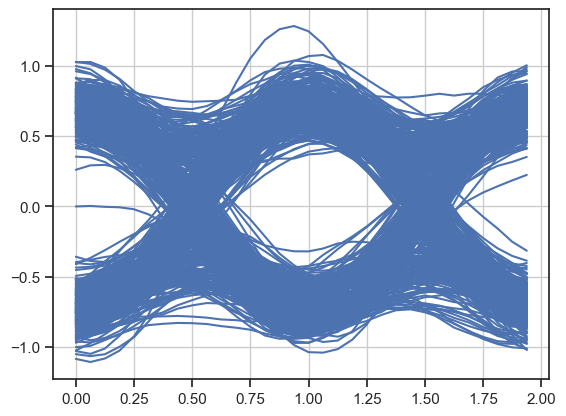

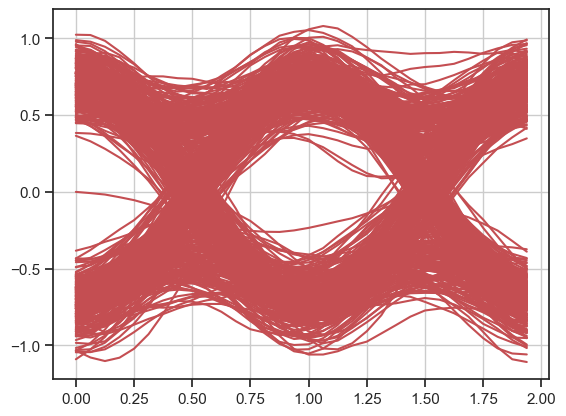

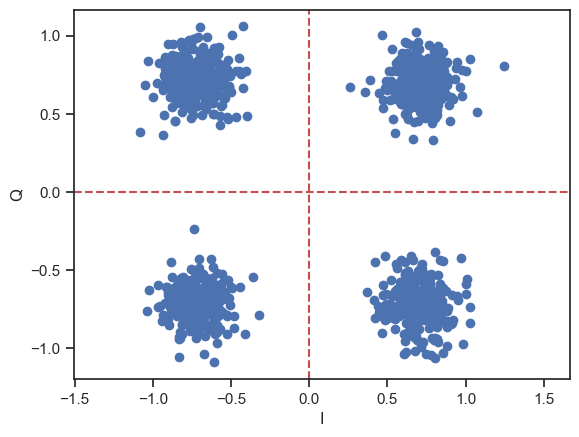

In [22]:
  # Eye Diagram plot of real part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.real(mf_out[n*2*fsT:(n+1)*2*fsT]), 'b')

plt.grid()
plt.show()

# Eye Diagram plot of imaginary part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.imag(mf_out[n*2*fsT:(n+1)*2*fsT]), 'r')

plt.grid()
plt.show()

plt.plot(np.real(Z), np.imag(Z), 'o')

plt.axis('equal')
plt.xlabel('I')
plt.ylabel('Q')

# decision boundaries
plt.axhline(0, color='r', ls='--')
plt.axvline(0, color='r', ls='--')


plt.show()

In [23]:
ser_simulated_qpsk

[np.float64(0.07454427083333333),
 np.float64(0.0427734375),
 np.float64(0.0252685546875),
 np.float64(0.013053385416666667),
 np.float64(0.005020532852564103),
 np.float64(0.0015356924019607843),
 np.float64(0.0003965736040609137),
 np.float64(7.272854217091789e-05),
 np.float64(7.832080200501253e-06),
 np.float64(5.2734375e-07),
 np.float64(3.90625e-08)]

In [24]:
ser_exact_qpsk

[np.float64(0.07393827014711016),
 np.float64(0.04548494931638666),
 np.float64(0.02501563284147128),
 np.float64(0.011972720144284665),
 np.float64(0.004820796772086215),
 np.float64(0.0015647896369452084),
 np.float64(0.0003879333137523519),
 np.float64(6.860407106282668e-05),
 np.float64(7.93848103775287e-06),
 np.float64(5.39029550835111e-07),
 np.float64(1.8722079893741142e-08)]

/var/folders/7y/zn2wsyn90v971fl99gkffxdh0000gn/T/ipykernel_23966/2611663802.py:4: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  plt.plot(snr_qpsk, ser_simulated_qpsk, 'ko', marker='o', linestyle='-')


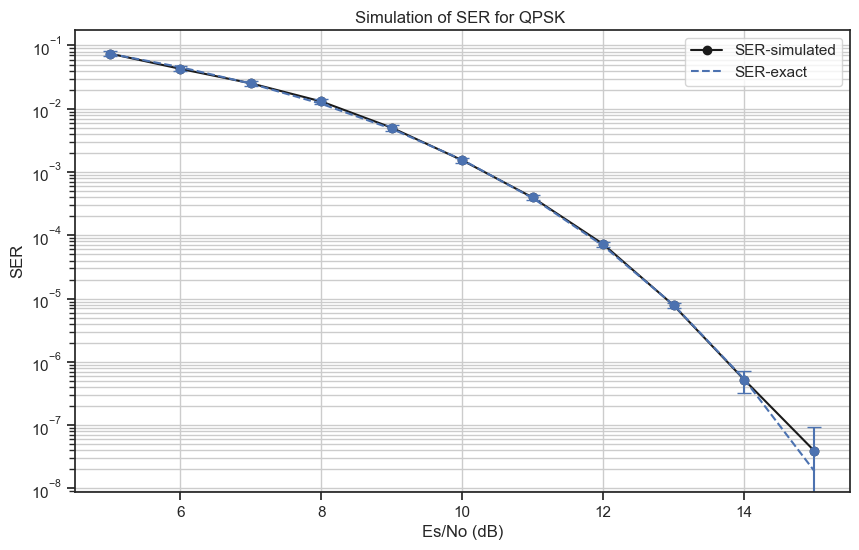

In [132]:
plt.figure(figsize=(10, 6))

# Plot SNR vs errors, with a logarithmic scale for the errors
plt.plot(snr_qpsk, ser_simulated_qpsk, 'ko', marker='o', linestyle='-')
plt.plot(snr_qpsk, ser_exact_qpsk, 'b', linestyle='--')

# Add error bars to show confidence intervals
lower_bound = [ser - ci for ser, ci in zip(ser_simulated_qpsk, confidence_intervals_qpsk)]
upper_bound = [ser + ci for ser, ci in zip(ser_simulated_qpsk, confidence_intervals_qpsk)]
plt.errorbar(snr_qpsk, ser_simulated_qpsk, yerr=confidence_intervals_qpsk, fmt='o', capsize=5)

# Set the y-axis to a logarithmic scale
plt.yscale('log')

# Add labels and title
plt.xlabel('Es/No (dB)')
plt.ylabel('SER')
plt.title('Simulation of SER for QPSK ')
plt.grid(True, which="both")  # Add gridlines for both major and minor ticks
plt.legend(['SER-simulated','SER-exact' ])

# Show the plot
plt.show()

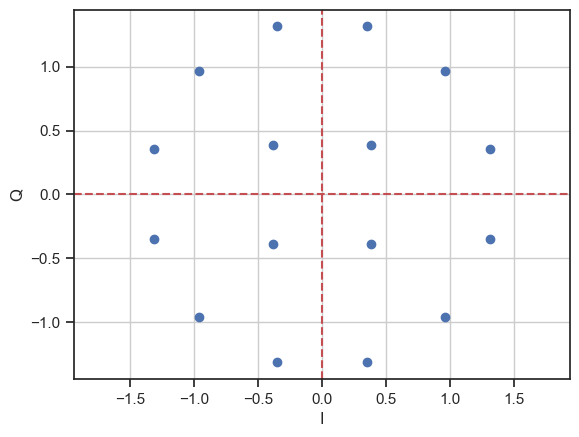

In [26]:
# Problem 3 (b)
# Solve for R1 and R2 based on the average energy constraint
# The equation is (54 * R1^2)/ 16 = Es
Es = 1
gamma = 2.5
R1 = np.sqrt((16/54)*Es)
R2 = gamma*R1
outer_const_4 = R2*np.array([np.exp(1j*np.pi/4), np.exp(1j*3*np.pi/4), np.exp(1j*5*np.pi/4), 
    np.exp(1j*7*np.pi/4)])
outer_const_8 = R2*np.array([np.exp(1j*np.pi/12),np.exp(1j*5*np.pi/12),np.exp(1j*7*np.pi/12),
    np.exp(1j*11*np.pi/12),np.exp(1j*13*np.pi/12),np.exp(1j*17*np.pi/12),np.exp(1j*19*np.pi/12),
    np.exp(1j*23*np.pi/12)])
inner_const = R1*np.array([np.exp(1j*np.pi/4), np.exp(1j*3*np.pi/4), np.exp(1j*5*np.pi/4), 
    np.exp(1j*7*np.pi/4)])
outer_const = np.concatenate((outer_const_4,outer_const_8))
apsk16_const = np.concatenate((inner_const,outer_const))
plt.plot(np.real(apsk16_const), np.imag(apsk16_const), 'o')
plt.grid()

plt.axis('equal')
plt.xlabel('I')
plt.ylabel('Q')

# decision boundaries
plt.axhline(0, color='r', ls='--')
plt.axvline(0, color='r', ls='--')


plt.show()

In [27]:
# Define a normalized 16PSK constellation
apsk16_const = apsk16_const
norm = np.mean(np.abs(apsk16_const)**2)
apsk16_const_norm = apsk16_const/np.sqrt(norm)
# print(apsk16_const_norm)
num_symbols = 1024
apsk16_sym = random_symbols(apsk16_const_norm, num_symbols)
avg_sym_energy = 1/num_symbols * np.sum(np.abs(apsk16_sym)**2)
print("average symbol energy before pulse shaping: ", avg_sym_energy)
fsT = 16

# Pulse shaping
pp = half_sine_pulse(fsT)  
mag_pp = np.sum(np.abs(pp)**2)
print("The energy of the pulse has to be one:", mag_pp)
ss = pulse_shape(apsk16_sym, pp, fsT)
print("average symbol energy after pulse shaping: ", 1/num_symbols * np.sum(np.abs(ss)**2))

average symbol energy before pulse shaping:  1.01142207278481
The energy of the pulse has to be one: 1.0
average symbol energy after pulse shaping:  1.0114220727848102


In [29]:
# Arrays to store results for 16-APSK
ser_simulated_16apsk = []
ser_nn_16apsk = []
confidence_intervals_16apsk = []
snr_16apsk = []
calc_snr = 18
snr_db_low = calc_snr - 5
snr_db_high = calc_snr + 4
energy_efficiency = 1.185
for snr_db in np.arange(snr_db_low,snr_db_high,1):
    snr_linear = 10**(snr_db/10)
    ser_theory = ser_apsk_16_nn((energy_efficiency*snr_linear)/8)
    # print(ser_theory)
    Z, mf_out,ser_sim, s_c = montecarlo_ser(snr_linear,ss,pp,apsk16_const_norm,apsk16_sym)
    ser_nn_16apsk.append(ser_theory)
    ser_simulated_16apsk.append(ser_sim)
    confidence_intervals_16apsk.append(s_c)
    snr_16apsk.append(snr_db)

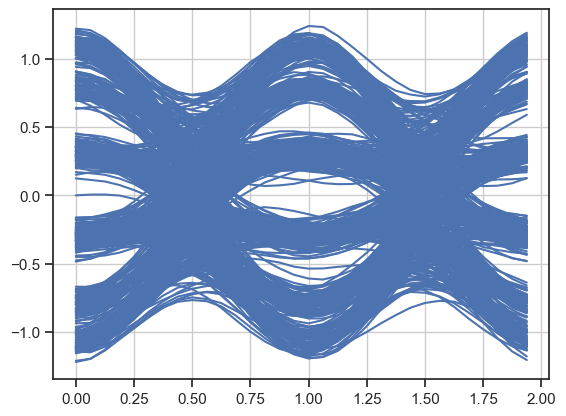

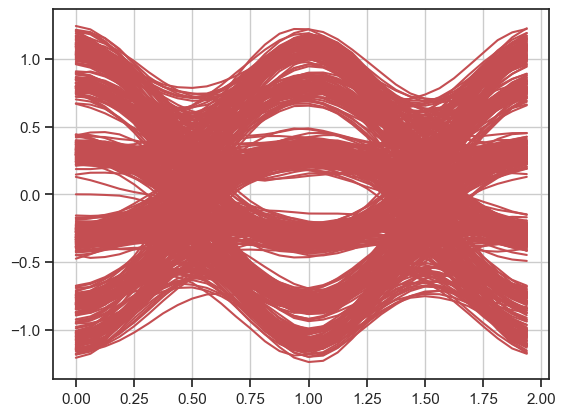

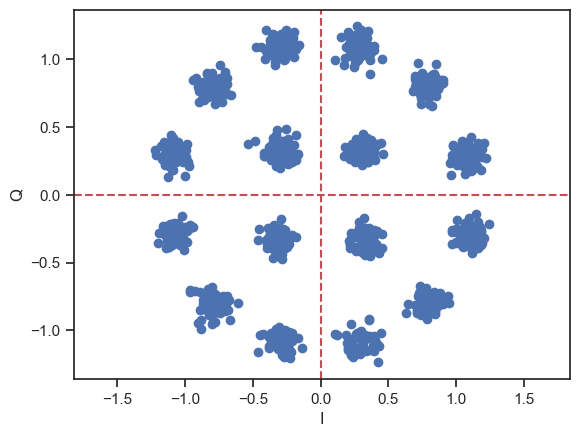

In [30]:
  # Eye Diagram plot of real part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.real(mf_out[n*2*fsT:(n+1)*2*fsT]), 'b')

plt.grid()
plt.show()

# Eye Diagram plot of imaginary part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.imag(mf_out[n*2*fsT:(n+1)*2*fsT]), 'r')

plt.grid()
plt.show()

plt.plot(np.real(Z), np.imag(Z), 'o')

plt.axis('equal')
plt.xlabel('I')
plt.ylabel('Q')

# decision boundaries
plt.axhline(0, color='r', ls='--')
plt.axvline(0, color='r', ls='--')


plt.show()

/var/folders/7y/zn2wsyn90v971fl99gkffxdh0000gn/T/ipykernel_23966/3651037876.py:4: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  plt.plot(snr_16apsk, ser_simulated_16apsk, 'ko', marker='o', linestyle='-')


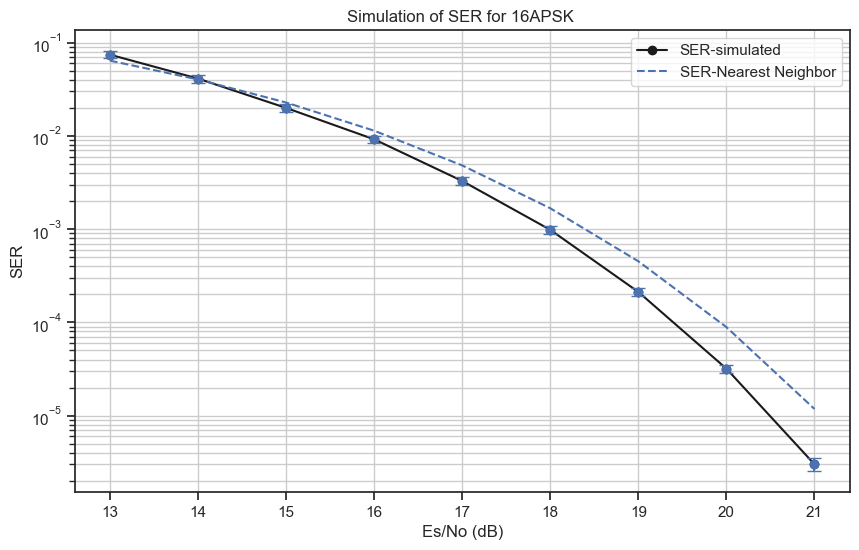

In [130]:
plt.figure(figsize=(10, 6))

# Plot SNR vs errors, with a logarithmic scale for the errors
plt.plot(snr_16apsk, ser_simulated_16apsk, 'ko', marker='o', linestyle='-')
plt.plot(snr_16apsk, ser_nn_16apsk, 'b', linestyle='--')

# Add error bars to show confidence intervals
lower_bound = [ser - ci for ser, ci in zip(ser_simulated_qpsk, confidence_intervals_16apsk)]
upper_bound = [ser + ci for ser, ci in zip(ser_simulated_qpsk, confidence_intervals_16apsk)]
plt.errorbar(snr_16apsk, ser_simulated_16apsk, yerr=confidence_intervals_16apsk, fmt='o', capsize=5)

# Set the y-axis to a logarithmic scale
plt.yscale('log')

# Add labels and title
plt.xlabel('Es/No (dB)')
plt.ylabel('SER')
plt.title('Simulation of SER for 16APSK ')
plt.grid(True, which="both")  # Add gridlines for both major and minor ticks
plt.legend(['SER-simulated','SER-Nearest Neighbor' ])

# Show the plot
plt.show()

#### Nearest Neighbor for 16APSK

$$
    \text{Pr}\{\text{symbol error}\} \approx 3/2 \cdot Q(\sqrt{\frac{\eta E_b}{2 N_0}})
$$
in terms of $E_b/N_0$.

In [32]:
def ber_apsk_16_nn(x):
    # Nearest neighbor approximation for 16apsk 
    nn_16apsk = (3/2)*Q(np.sqrt(x))
    return nn_16apsk

In [113]:

def montecarlo_ber(SNR_LINEAR,ss,pp,const,symbols,bits_in):
    MAX_ERRORS=400
    MAX_BURSTS=20000
    N_bursts = 0
    N_errors = 0
    while N_bursts < MAX_BURSTS and N_errors < MAX_ERRORS:
        noise_var = Eb/SNR_LINEAR
        sigma = np.sqrt(noise_var/2)
        noise = sigma*(np.random.randn(len(ss)) + 1j*np.random.randn(len(ss)))
        # channel (add gaussian noise)
        tx_data = ss + noise
        # Receiver
        rx_data = tx_data
        # Apply matched filter
        mf = np.flip(pp)
        mf_out = np.convolve(rx_data, mf)
        Z = mf_out[fsT:-fsT:fsT]
        # dec = MPE_decision_rule(Z, apsk16_const_norm)
        
        bits_out = demodulator(Z,symbols)
        # print(len(dec))

       # Evaluate simulation errors
        N_bursts += 1
        # N_errors += np.sum(np.not_equal(dec, apsk16_mod_data))
        N_errors += np.sum(np.not_equal(bits_out, bits_in))
        # print(N_errors)
# 
    # Simulated BER
    # print(N_errors)
    M = len(bits_in) * N_bursts  # Total symbols transmitted
    ber_sim =  N_errors/M
    # Simulated SER
    # M = num_symbols * N_bursts  # Total symbols transmitted
    # ser_sim =  N_errors/M
    # print(N_errors)
    # Calculate 95% confidence interval for the simulated SER
    z_c = 1.96  # 95% confidence level
    if N_errors > 0:
        s_c = z_c * np.sqrt((ber_sim * (1 - ber_sim)) / M)
    else:
        s_c = 0  # No errors, no confidence interval needed

    return Z, mf_out, ber_sim, s_c

In [114]:
Es = 1
gamma = 2.5
R1 = np.sqrt((16/54)*Es)
R2 = gamma*R1
outer_const_4 = R2*np.array([np.exp(1j*np.pi/4), np.exp(1j*3*np.pi/4), np.exp(1j*5*np.pi/4), 
    np.exp(1j*7*np.pi/4)])
outer_const_8 = R2*np.array([np.exp(1j*np.pi/12),np.exp(1j*5*np.pi/12),np.exp(1j*7*np.pi/12),
    np.exp(1j*11*np.pi/12),np.exp(1j*13*np.pi/12),np.exp(1j*17*np.pi/12),np.exp(1j*19*np.pi/12),
    np.exp(1j*23*np.pi/12)])
inner_const = R1*np.array([np.exp(1j*np.pi/4), np.exp(1j*3*np.pi/4), np.exp(1j*5*np.pi/4), 
    np.exp(1j*7*np.pi/4)])
outer_const = np.concatenate((outer_const_4,outer_const_8))
apsk16_const = np.concatenate((inner_const,outer_const))

In [115]:
# Problem 3C
Eb = Es/int(np.log2(16))
# Define a normalized 16PSK constellation
apsk16_const = apsk16_const
norm = np.mean(np.abs(apsk16_const)**2)
apsk16_const_norm = apsk16_const/np.sqrt(norm)
apsk16 = {
    0o14: apsk16_const_norm[0],   # 1100 in binary
    0o16: apsk16_const_norm[1],   # 1110 in binary
    0o17: apsk16_const_norm[2],   # 1111 in binary
    0o15: apsk16_const_norm[3],   # 1101 in binary
    0o00: apsk16_const_norm[4],   # 0000 in binary
    0o02: apsk16_const_norm[5],   # 0010 in binary
    0o03: apsk16_const_norm[6],   # 0011 in binary
    0o01: apsk16_const_norm[7],   # 0001 in binary
    0o04: apsk16_const_norm[8],   # 0100 in binary
    0o10: apsk16_const_norm[9],   # 1000 in binary
    0o12: apsk16_const_norm[10],  # 1010 in binary
    0o06: apsk16_const_norm[11],  # 0110 in binary
    0o07: apsk16_const_norm[12],  # 0111 in binary
    0o13: apsk16_const_norm[13],  # 1011 in binary
    0o11: apsk16_const_norm[14],  # 1001 in binary
    0o05: apsk16_const_norm[15],  # 0101 in binary
}
num_symbols = 1024
bits_in = [random.getrandbits(1) for _ in range(num_symbols*int(np.log2(16)))]
apsk16_mod_data = mod_mapper(bits_in,apsk16)
avg_sym_energy = 1/num_symbols * np.sum(np.abs(apsk16_mod_data)**2)
print("average symbol energy before pulse shaping: ", avg_sym_energy)
fsT = 16

# Pulse shaping
pp = half_sine_pulse(fsT)  
mag_pp = np.sum(np.abs(pp)**2)
print("The energy of the pulse has to be one:", mag_pp)
ss = pulse_shape(apsk16_mod_data, pp, fsT)
print("average symbol energy after pulse shaping: ", 1/num_symbols * np.sum(np.abs(ss)**2))

average symbol energy before pulse shaping:  1.0041534810126582
The energy of the pulse has to be one: 1.0
average symbol energy after pulse shaping:  1.0041534810126582


In [117]:
# Arrays to store results for 16-APSK
ber_simulated = []
ber_nn = []
confidence_intervals = []
snr = []
calc_snr = 14
snr_db_low = calc_snr - 5
snr_db_high = calc_snr + 4
energy_efficiency = 1.185
for snr_db in np.arange(snr_db_low,21,1):
    print(snr_db)
    snr_linear = 10**(snr_db/10)
    ser_theory = ber_apsk_16_nn((energy_efficiency*snr_linear)/2)
    # print(ser_theory)
    Z, mf_out,ber_sim, s_c = montecarlo_ber(snr_linear,ss,pp,apsk16_const_norm,apsk16,bits_in)
    print(ber_sim)
    ber_nn.append(ser_theory)
    ber_simulated.append(ber_sim)
    confidence_intervals.append(s_c)
    snr.append(snr_db)

9
0.005547417534722222
10
0.002429496951219512
11
0.0008288471638655462
12
0.00022927491949648713
13
4.713139478764479e-05
14
7.722914195334124e-06
15
6.591796875e-07
16
1.220703125e-08
17
0.0
18
0.0
19
0.0
20
0.0


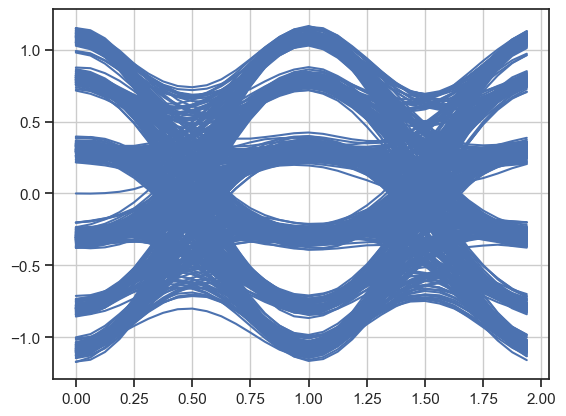

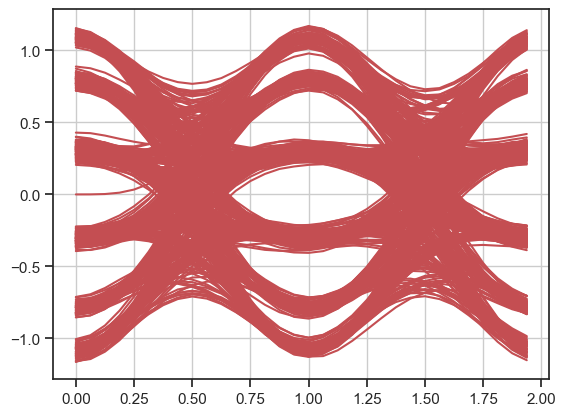

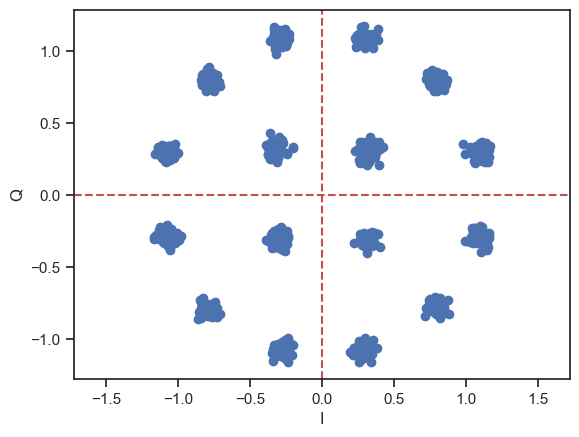

In [86]:
  # Eye Diagram plot of real part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.real(mf_out[n*2*fsT:(n+1)*2*fsT]), 'b')

plt.grid()
plt.show()

# Eye Diagram plot of imaginary part only
for n in range(len(ss)//(2*fsT)):
    plt.plot(np.arange(2*fsT)/fsT, np.imag(mf_out[n*2*fsT:(n+1)*2*fsT]), 'r')

plt.grid()
plt.show()

plt.plot(np.real(Z), np.imag(Z), 'o')

plt.axis('equal')
plt.xlabel('I')
plt.ylabel('Q')

# decision boundaries
plt.axhline(0, color='r', ls='--')
plt.axvline(0, color='r', ls='--')


plt.show()

/var/folders/7y/zn2wsyn90v971fl99gkffxdh0000gn/T/ipykernel_23966/2981192377.py:4: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  plt.semilogy(snr, ber_simulated, 'ko', marker='o', linestyle='-')


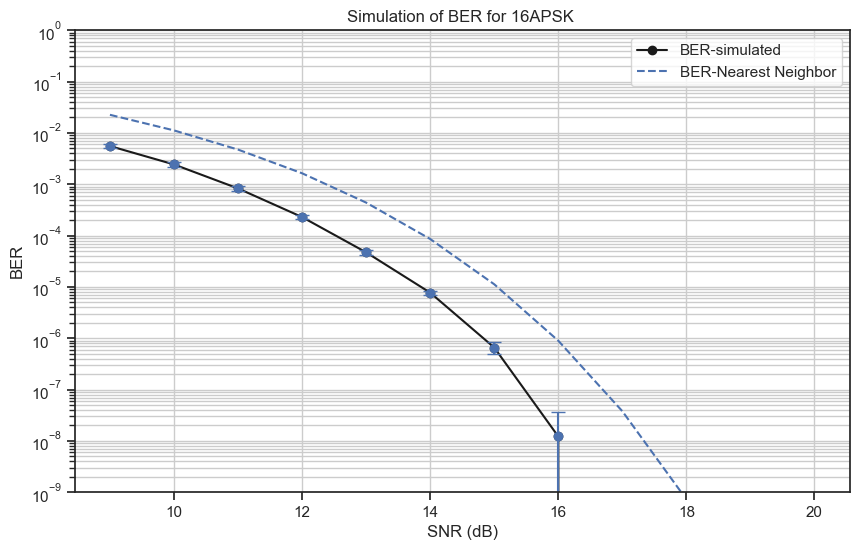

In [128]:
plt.figure(figsize=(10, 6))

# Plot SNR vs errors, with a logarithmic scale for the errors
plt.semilogy(snr, ber_simulated, 'ko', marker='o', linestyle='-')
plt.semilogy(snr, ber_nn, 'b', linestyle='--')

# Add error bars to show confidence intervals
lower_bound = [ser - ci for ser, ci in zip(ber_simulated, confidence_intervals)]
upper_bound = [ser + ci for ser, ci in zip(ber_simulated, confidence_intervals)]
plt.errorbar(snr, ber_simulated, yerr=confidence_intervals, fmt='o', capsize=5)
plt.ylim(10**-9, 10**-0)
# Set the y-axis to a logarithmic scale
# plt.yscale('log')

# Add labels and title
plt.xlabel('Eb/No (dB)')
plt.ylabel('BER')
plt.title('Simulation of BER for 16APSK ')
plt.grid(True, which="both")  # Add gridlines for both major and minor ticks
plt.legend(['BER-simulated','BER-Nearest Neighbor' ])

# Show the plot
plt.show()

In [186]:
_bpsk_map = lambda b: (1 - 2 * b[0]) 

In [187]:
BPSK = {n: _bpsk_map(int_to_bits(n, 1)) for n in range(2)}

/var/folders/7y/zn2wsyn90v971fl99gkffxdh0000gn/T/ipykernel_23966/2181650462.py:1: RuntimeWarning: overflow encountered in scalar subtract
  _bpsk_map = lambda b: (1 - 2 * b[0])


In [196]:
a = int_to_bits(1,1)
a[0]

np.uint8(1)

In [197]:
_bpsk_map(a)

/var/folders/7y/zn2wsyn90v971fl99gkffxdh0000gn/T/ipykernel_23966/2181650462.py:1: RuntimeWarning: overflow encountered in scalar subtract
  _bpsk_map = lambda b: (1 - 2 * b[0])


np.uint8(255)